# Imports

In [1]:
######## Common ########
import pandas as pd
import os
import copy
from collections import Counter
import ast  # To safely evaluate list-like strings
from pathlib import Path
import numpy as np


######## Sound ########
import librosa
import librosa.display
from mutagen.oggvorbis import OggVorbis
# Human Voices Detection
from silero_vad import get_speech_timestamps, save_audio

######## Machine Learning ########
import torch
import torchaudio
import torchaudio.transforms as T
from torchaudio.transforms import TimeStretch, FrequencyMasking, TimeMasking, Vol, Spectrogram, MelSpectrogram

######## Data Processing ########
from sklearn.model_selection import train_test_split

######## Visualization ########
# Audio
import IPython.display as ipd
# Ploting
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
# Geographical Maps
import geopandas as gpd
import contextily as ctx



# Audio Data

Read datasets into dataframes. Contain audio file path, label and additional information

In [2]:
train_df = pd.read_csv('preprocessed data/train.csv')
val_df = pd.read_csv('preprocessed data/validation.csv')
test_df = pd.read_csv('preprocessed data/test.csv')

Get paths to project and data directory

In [3]:
# get current directory
project_path = os.getcwd()
train_audio_dir_path = os.path.join(project_path, r"data/train_audio")

Example dataframe

In [4]:
train_df

,primary_label,secondary_labels,filename,collection,rating,scientific_name,common_name,animal_class,duration_in_seconds
0,amekes,[''],amekes/iNat1149684.ogg,iNat,0.0,Falco sparverius,American Kestrel,Aves,9.264781
1,566513,[''],566513/iNat832952.ogg,iNat,0.0,Alouatta seniculus,Colombian Red Howler Monkey,Mammalia,30.835938
2,22333,[''],22333/iNat1155704.ogg,iNat,0.0,Eleutherodactylus johnstonei,Lesser Antillean whistling frog,Amphibia,9.914938
3,41970,[''],41970/iNat327629.ogg,iNat,0.0,Panthera onca,Jaguar,Mammalia,13.480500
4,48124,[''],48124/CSA34485.ogg,CSA,0.0,Tettigoniidae,Katydids,Insecta,114.966031
...,...,...,...,...,...,...,...,...,...
328,22973,[''],22973/iNat1243033.ogg,iNat,0.0,Leptodactylus fuscus,Whistling Grass Frog,Amphibia,12.584969
329,42007,[''],42007/iNat606215.ogg,iNat,0.0,Puma concolor,Mountain Lion,Mammalia,6.848000
330,anhing,[''],anhing/XC898190.ogg,XC,4.0,Anhinga anhinga,Anhinga,Aves,32.528438
331,amekes,[''],amekes/iNat1074415.ogg,iNat,0.0,Falco sparverius,American Kestrel,Aves,22.357344


# Audio Data

### Get audio file metadata - recording length in seconds
**Mutagen Package** <br>
Audio files vary in length which is important to take into account. We can check the length of an audio file using packages such as **mutagen** (mutagen.oggvorbis import OggVorbis). This package allows us to read .ogg file's metadata.

In [5]:
# Function to get the length of the audio file from metadata
def get_audio_length(audio_file_path):
    audio = OggVorbis(audio_file_path)
    return audio.info.length  # Returns length in seconds

# Audio file path
file_name = "21038/iNat297879.ogg"
audio_file_path = os.path.join(train_audio_dir_path, file_name)

print("####### EXAMPLE #######")
print(f"File: {file_name}\nLength: {get_audio_length(audio_file_path)} seconds\n")

####### EXAMPLE #######
File: 21038/iNat297879.ogg
Length: 11.136 seconds



### Read Audio Data

Read audio file into waveform and sample rate data
* wav (Waveform) - tensor containing raw audio waveform of shape changles,samples.
* sr (Sample Rate) - an integer representing the number of samples per second (Hz)

In [6]:
# Audio file path
file_name = "21038/iNat297879.ogg"
audio_file_path = os.path.join(train_audio_dir_path, file_name)

# Get Audio Data
wav, sr = torchaudio.load(audio_file_path)

Play original audio

In [7]:
# Play original audio
print("Original Audio:")
display(ipd.Audio(audio_file_path))

Original Audio:


### Audio Data Feature Extruction

**Librosa** <br>
Librosa is a python library for music and audio analysis, built on NumPy and SciPy. <br>

Pros:
* Easy to use, beginner-friendly.
* Extensive support for feature extraction (e.g., MFCC, Chroma, Spectrograms).
* Rich visualization tools (e.g., waveforms, spectrograms).
* Well-documented and widely adopted in research.

Cons:
* Not GPU-accelerated.
* Slower for large-scale or real-time processing.
* Doesn't integrate tightly with PyTorch pipelines.ines.


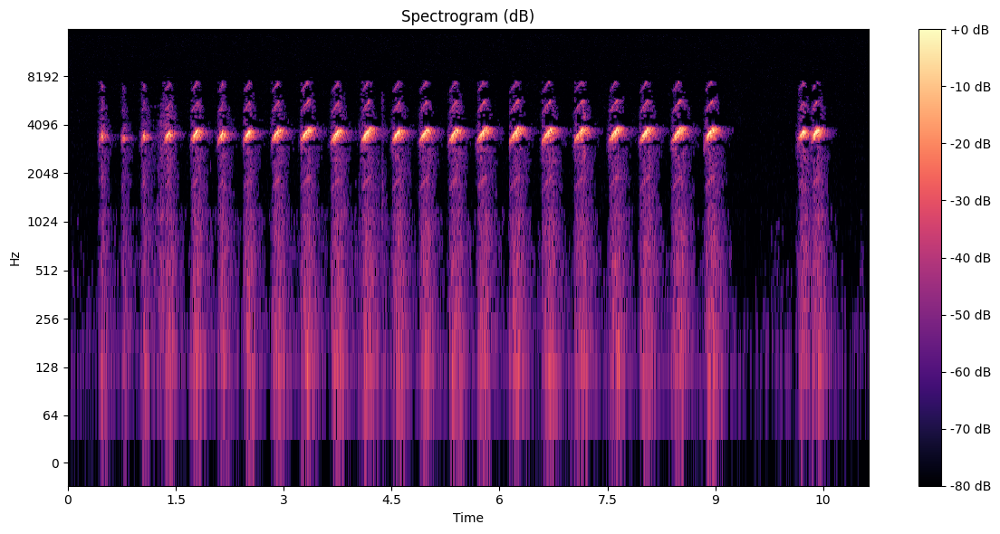

In [12]:
# Load audio file
y, sr = librosa.load(audio_file_path, sr=None)  # sr=None keeps original sampling rate

# Parameters for STFT
n_fft = 512        # Window size (in samples)
hop_length = 254    # Number of samples between successive frames (75% overlap when windows size is 2048)
win_length = n_fft  # Use same window length as n_fft
window = 'hann'     # Window function

# Compute STFT (complex-valued)
D = librosa.stft(y, n_fft=n_fft, hop_length=hop_length, win_length=win_length, window=window)

# Convert to magnitude spectrogram (decibels)
S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)

# Plot the spectrogram
plt.figure(figsize=(12, 6))
librosa.display.specshow(S_db, sr=sr, hop_length=hop_length, x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')
plt.title('Spectrogram (dB)')
plt.tight_layout()
plt.show()

**Torchaudio** <br>
Torchaudio is a pyTorch domain library for audio, tightly integrated with the PyTorch ecosystem. <br>


Pros
* Native PyTorch integration (easy for model pipelines).
* GPU support and batched processing.
* Pre-trained models and datasets available.
* More scalable for deep learning..

Cons
* Smaller community and fewer examples than Librosa.
* Less intuitive for beginners.
* Limited visualization tools (requires external libs).l libs).
.

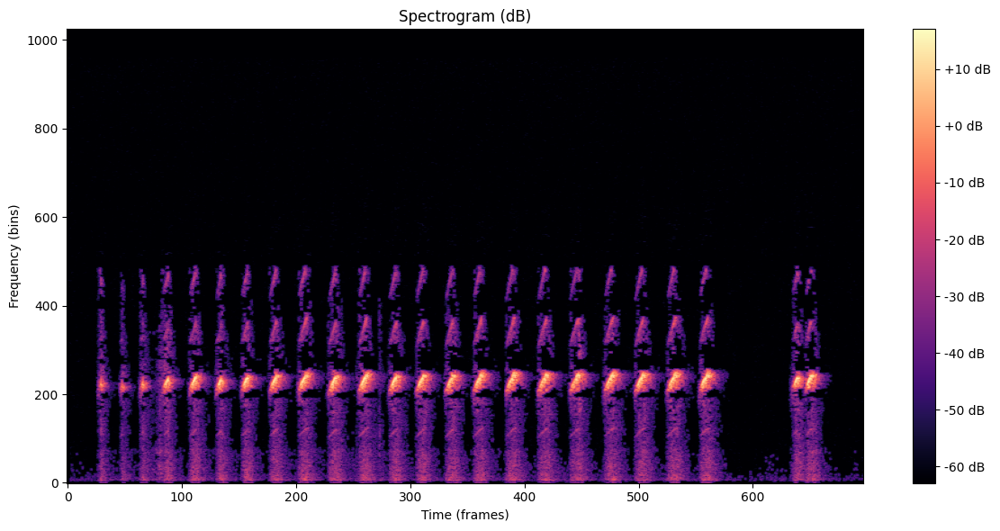

In [13]:
# Load audio using torchaudio
waveform, sr = torchaudio.load(audio_file_path)  # waveform: (channels, samples)

# If stereo, convert to mono (mean over channels)
if waveform.shape[0] > 1:
    waveform = waveform.mean(dim=0, keepdim=True)

# Parameters
n_fft = 2048 # Window size (in samples)
hop_length = 512 # Number of samples between successive frames
win_length = n_fft # Use same window length as n_fft
window_fn = torch.hann_window # To reduce spectral likage (take care of window sides)

# Create the Spectrogram transform
spectrogram_transform = T.Spectrogram(
    n_fft=n_fft, 
    win_length=win_length,
    hop_length=hop_length,
    window_fn=window_fn,
    power=2.0,        # 2.0 = power spectrogram (magnitude squared)
    normalized=False,
)

# Apply the transform
spec = spectrogram_transform(waveform)  # shape: (channel, freq, time)

# Convert to decibels
db_transform = T.AmplitudeToDB(stype="power", top_db=80)
spec_db = db_transform(spec)

# Plot
plt.figure(figsize=(12, 6))
plt.imshow(spec_db[0].numpy(), origin="lower", aspect="auto", cmap="magma")
plt.title("Spectrogram (dB)")
plt.xlabel("Time (frames)")
plt.ylabel("Frequency (bins)")
plt.colorbar(format="%+2.0f dB")
plt.tight_layout()
plt.show()

**Machine Learning Spectograms** <br>
When working with audio in machine learning, There are common suggestions:
* Use Mel Spectogram - A spectogram after mel scaling which mimics human auditory perception (non-linear freq scale)
* Apply log to the mel spectogram - Compresses dynamic range, stabilizes learning
* Perform Normalization - Makes data comparable across samples; good for neural networks

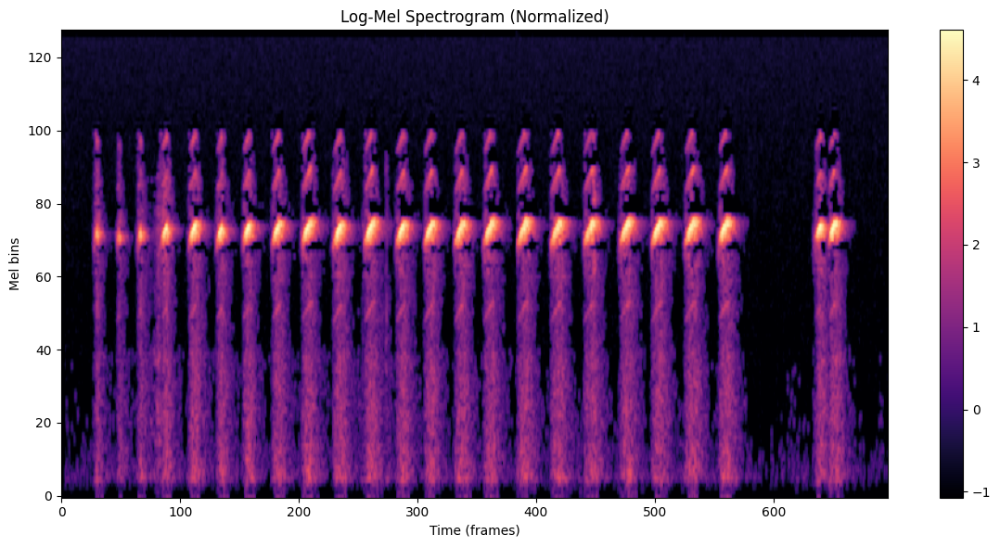

In [14]:
# Parameters
n_fft = 2048
hop_length = 512
n_mels = 128
win_length = n_fft

# Mel Spectrogram Transform
mel_transform = T.MelSpectrogram(
    sample_rate=sr,
    n_fft=n_fft,
    hop_length=hop_length,
    win_length=win_length,
    window_fn=torch.hann_window,
    n_mels=n_mels,
    power=2.0,  # Power spectrogram
)

# Convert to Mel Spectrogram
mel_spec = mel_transform(waveform)  # shape: (1, n_mels, time)

# Convert to log scale (dB)
db_transform = T.AmplitudeToDB(stype="power", top_db=80)
log_mel_spec = db_transform(mel_spec)

# Normalize: zero-mean, unit variance (channel-wise)
mean = log_mel_spec.mean()
std = log_mel_spec.std()
log_mel_spec_norm = (log_mel_spec - mean) / (std + 1e-9)

# Plot
plt.figure(figsize=(12, 6))
plt.imshow(log_mel_spec_norm[0].numpy(), origin="lower", aspect="auto", cmap="magma")
plt.title("Log-Mel Spectrogram (Normalized)")
plt.xlabel("Time (frames)")
plt.ylabel("Mel bins")
plt.colorbar()
plt.tight_layout()
plt.show()

**Time/Frequancy Masking** <br>
Time and frequency masking are data augmentation techniques introduced in SpecAugment (Google, 2019). They're simple yet powerful: by randomly hiding parts of the spectrogram, we force the model to become more robust to missing or noisy features.

**Time Masking** - Masks out a range of time steps (horizontal bands), Makes model robust to partial dropout of signal over time (e.g., stutters, brief silences)

**Frequancy Masking** - Masks out a range of frequencies (vertical bands), Forces the model to generalize across partial frequency loss (e.g., mic or environment quirks)

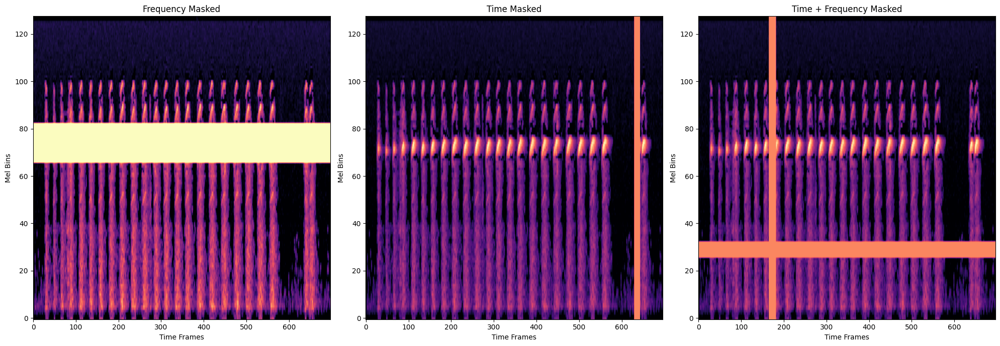

In [15]:
# --- Frequency Masking ---
freq_masked = T.FrequencyMasking(freq_mask_param=20)(log_mel_spec)

# --- Time Masking ---
time_masked = T.TimeMasking(time_mask_param=30)(log_mel_spec)

# --- Both Together ---
both_masked = T.TimeMasking(time_mask_param=30)(
    T.FrequencyMasking(freq_mask_param=20)(log_mel_spec.clone())
)

# --- Plotting ---
fig, axs = plt.subplots(1, 3, figsize=(20, 7))

# axs[0].imshow(log_mel_spec[0].numpy(), origin='lower', aspect='auto', cmap='magma')
# axs[0].set_title("Original Log-Mel")

axs[0].imshow(freq_masked[0].numpy(), origin='lower', aspect='auto', cmap='magma')
axs[0].set_title("Frequency Masked")

axs[1].imshow(time_masked[0].numpy(), origin='lower', aspect='auto', cmap='magma')
axs[1].set_title("Time Masked")

axs[2].imshow(both_masked[0].numpy(), origin='lower', aspect='auto', cmap='magma')
axs[2].set_title("Time + Frequency Masked")

for ax in axs:
    ax.set_xlabel("Time Frames")
    ax.set_ylabel("Mel Bins")

plt.tight_layout()
plt.show()


Additional information that can be extructed from audio:
* **Chromagram** - Representation of pitch classes (useful for musical analysis).
* **MFCC (Mel-Frequency Cepstral Coefficients)** – Features often used in speech and sound classification.
* **Zero Crossing Rate** – Number of times the signal crosses zero, useful for detecting percussive sounds.
* **Spectral Centroid** – Indicates where the "center of mass" of the frequency distribution is.
* **Spectral Bandwidth** – Measures how spread the spectrum is.
* **Spectral Rolloff** – The frequency below which a certain percentage of the total spectral energy is contained.

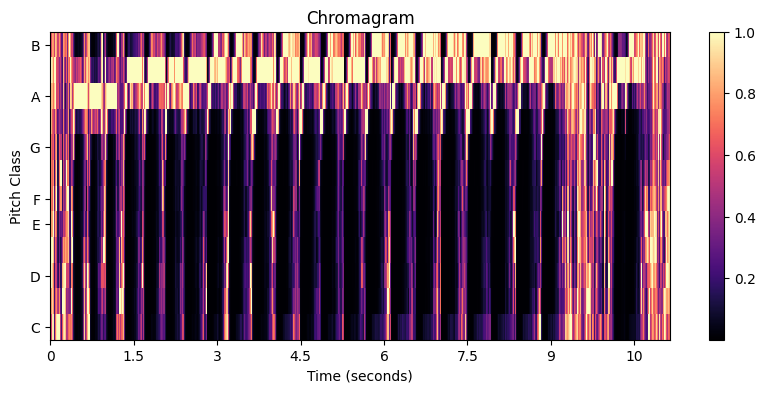

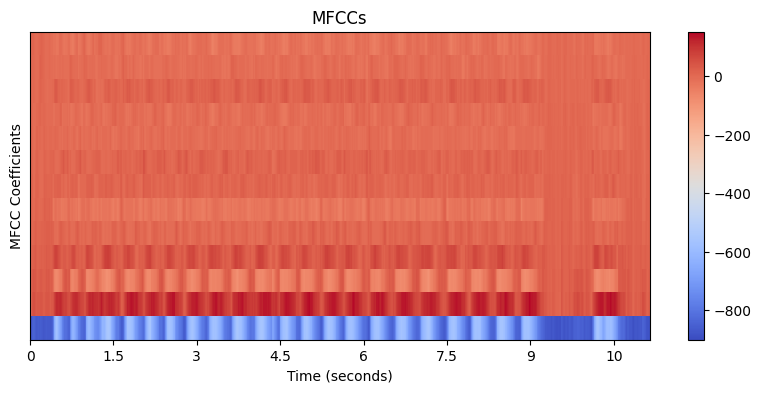

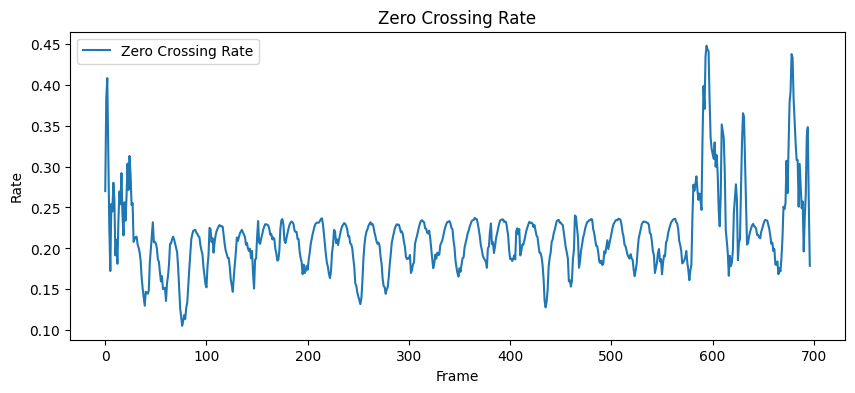

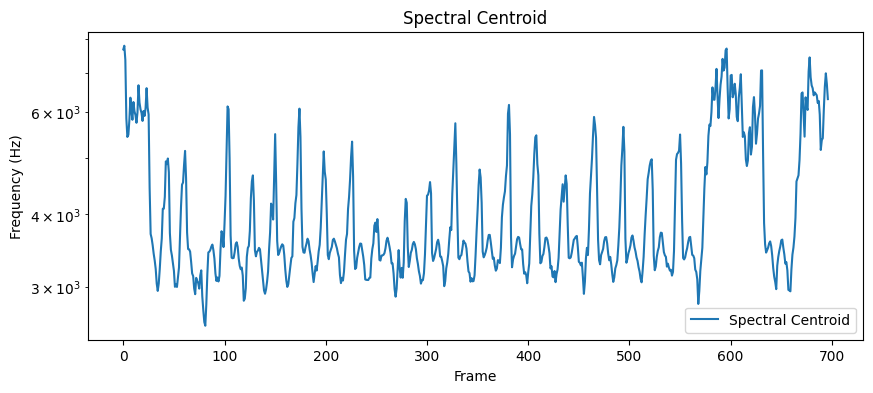

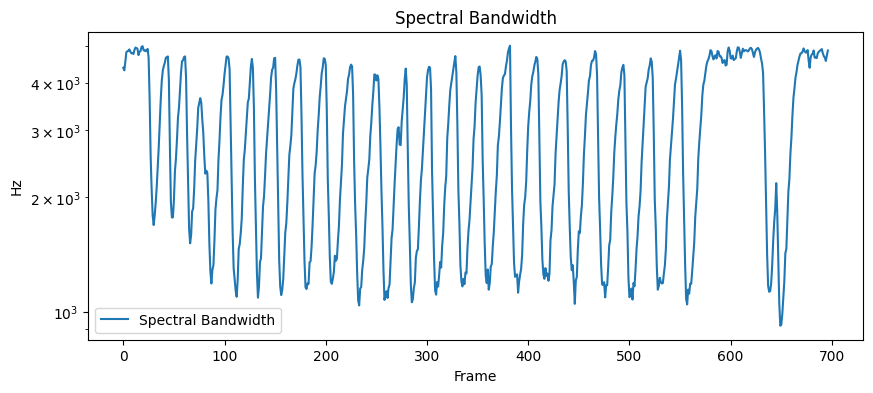

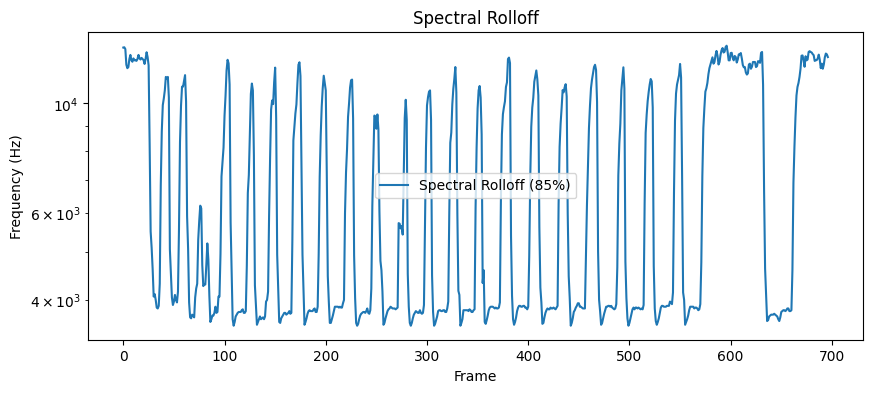

In [16]:
# 🎼 Compute Chromagram (Shows intensity of each pitch class)
chroma = librosa.feature.chroma_stft(y=y, sr=sr)

# 🎨 Plot 4: Chromagram
plt.figure(figsize=(10, 4))
librosa.display.specshow(chroma, sr=sr, hop_length=512, x_axis="time", y_axis="chroma")
plt.colorbar()
plt.title("Chromagram")
plt.xlabel("Time (seconds)")
plt.ylabel("Pitch Class")
plt.show()

# 🎙 Compute MFCCs (Mel-Frequency Cepstral Coefficients)
mfccs = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=13)

# 🎨 Plot 5: MFCCs
plt.figure(figsize=(10, 4))
librosa.display.specshow(mfccs, sr=sr, hop_length=512, x_axis="time")
plt.colorbar()
plt.title("MFCCs")
plt.xlabel("Time (seconds)")
plt.ylabel("MFCC Coefficients")
plt.show()

# 🔹 Compute Zero Crossing Rate (How many times the waveform crosses zero)
zero_crossings = librosa.feature.zero_crossing_rate(y)

# 🎨 Plot 6: Zero Crossing Rate
plt.figure(figsize=(10, 4))
plt.plot(zero_crossings[0], label="Zero Crossing Rate")
plt.title("Zero Crossing Rate")
plt.xlabel("Frame")
plt.ylabel("Rate")
plt.legend()
plt.show()

# 🔹 Compute Spectral Centroid (Center of mass of spectrum)
spectral_centroid = librosa.feature.spectral_centroid(y=y, sr=sr)

# 🎨 Plot 7: Spectral Centroid
plt.figure(figsize=(10, 4))
plt.semilogy(spectral_centroid.T, label="Spectral Centroid")
plt.title("Spectral Centroid")
plt.xlabel("Frame")
plt.ylabel("Frequency (Hz)")
plt.legend()
plt.show()

# 🔹 Compute Spectral Bandwidth (Spread of the spectrum)
spectral_bandwidth = librosa.feature.spectral_bandwidth(y=y, sr=sr)

# 🎨 Plot 8: Spectral Bandwidth
plt.figure(figsize=(10, 4))
plt.semilogy(spectral_bandwidth.T, label="Spectral Bandwidth")
plt.title("Spectral Bandwidth")
plt.xlabel("Frame")
plt.ylabel("Hz")
plt.legend()
plt.show()

# 🔹 Compute Spectral Rolloff (Frequency where 85% of energy is below)
spectral_rolloff = librosa.feature.spectral_rolloff(y=y, sr=sr, roll_percent=0.85)

# 🎨 Plot 9: Spectral Rolloff
plt.figure(figsize=(10, 4))
plt.semilogy(spectral_rolloff.T, label="Spectral Rolloff (85%)")
plt.title("Spectral Rolloff")
plt.xlabel("Frame")
plt.ylabel("Frequency (Hz)")
plt.legend()
plt.show()

# Human Voice Detection
The animal sounds audio files contain human voices sometimes (researcher recording the animal performs a sumery or descripition). This will confuse a model which attempts to classify animal sounds to specific animal classes, thus the data need to be cleaned from those voices.

### Silero VAD (Voice Activity Detection) 
Silero VAD (Voice Activity Detection) is a deep learning-based model designed to detect human speech in an audio signal. It is lightweight, efficient, and trained specifically to recognize human speech while ignoring background noise. Silero VAD is based on a fully convolutional neural network (FCNN) with temporal convolutional layers, making it well-suited for real-time voice activity detection.

Load VAD model to allow ditection of human speach in audio with timestamps for removel.

In [17]:
# Load Silero VAD model
human_speach_ditection_model, utils = torch.hub.load('snakers4/silero-vad', 'silero_vad', force_reload=True, trust_repo=True)
get_speech_timestamps, save_audio, read_audio, VADIterator, collect_chunks = utils

Downloading: "https://github.com/snakers4/silero-vad/zipball/master" to /home/dzega/.cache/torch/hub/master.zip


Detecting and removing human speach





File: amekes/iNat1149684.ogg
No speech detected in this file.




File: 566513/iNat832952.ogg
Original Audio:


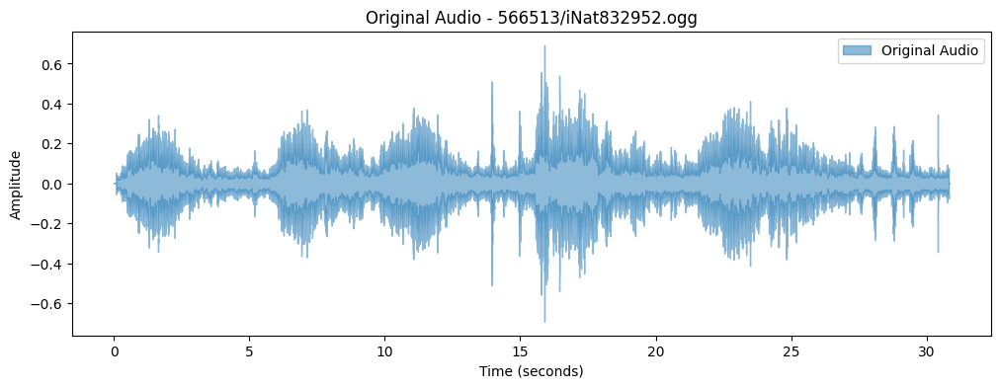

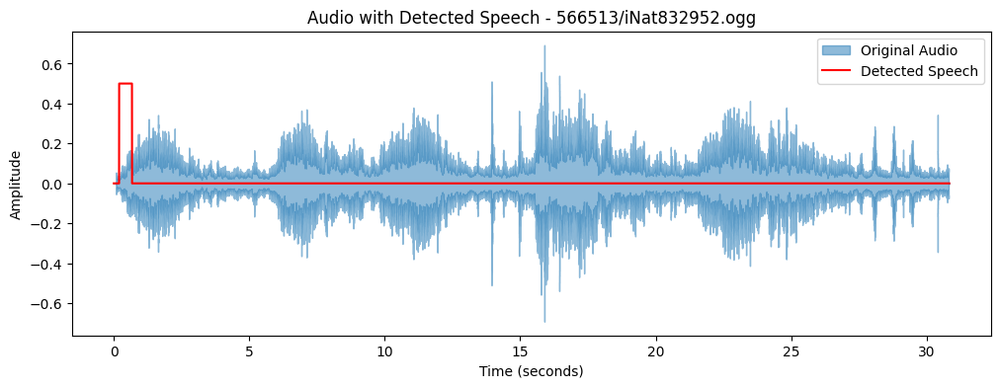





File: 22333/iNat1155704.ogg
No speech detected in this file.




File: 41970/iNat327629.ogg
No speech detected in this file.




File: 48124/CSA34485.ogg
Original Audio:


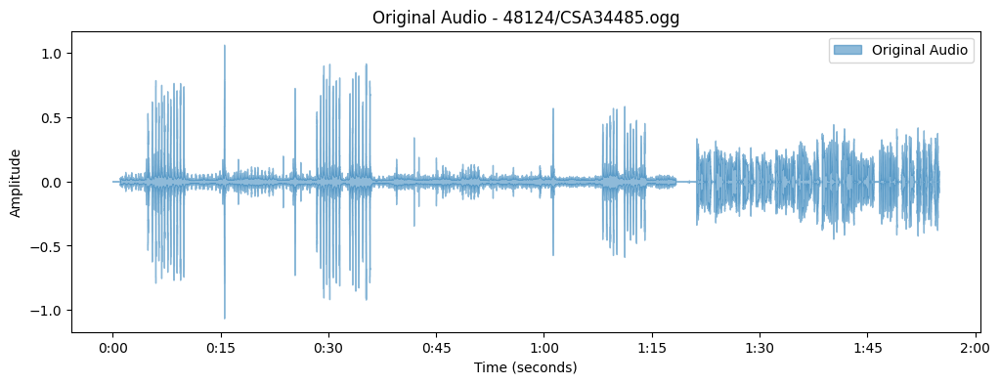

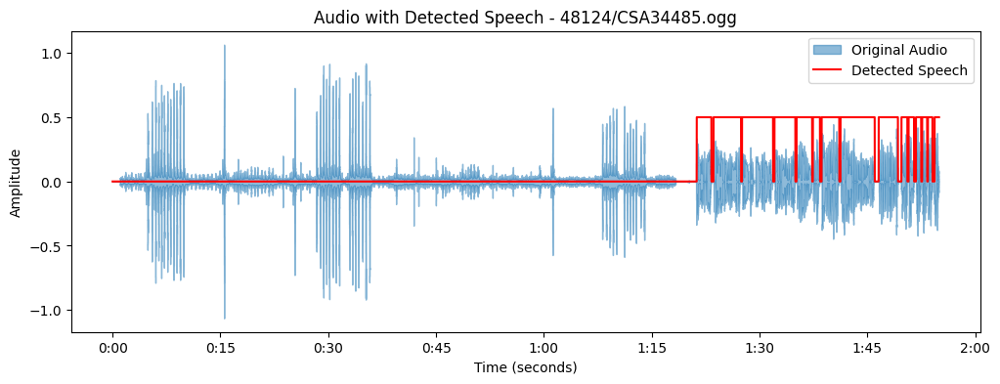





File: 22973/iNat326860.ogg
No speech detected in this file.




File: 22973/iNat1257590.ogg
No speech detected in this file.




File: 715170/CSA34515.ogg
Original Audio:


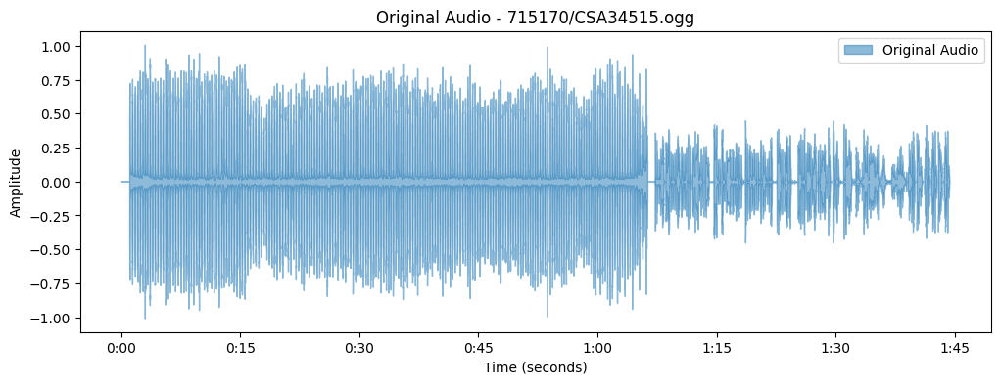

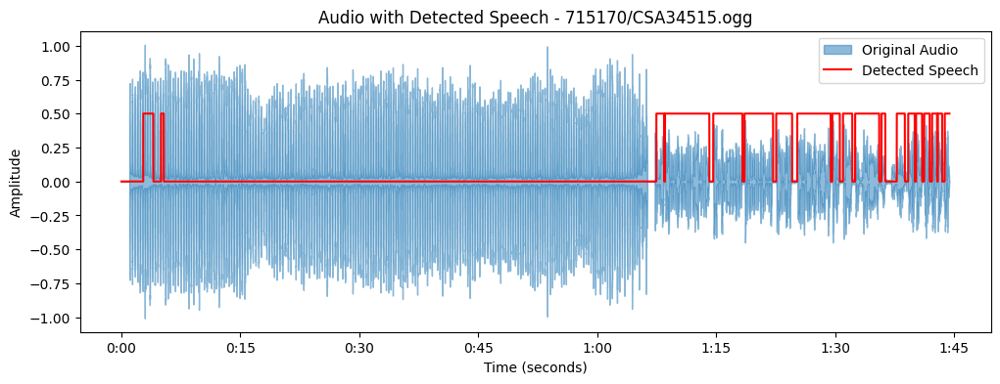





File: 517119/iNat949336.ogg
No speech detected in this file.




File: 48124/CSA35184.ogg
Original Audio:


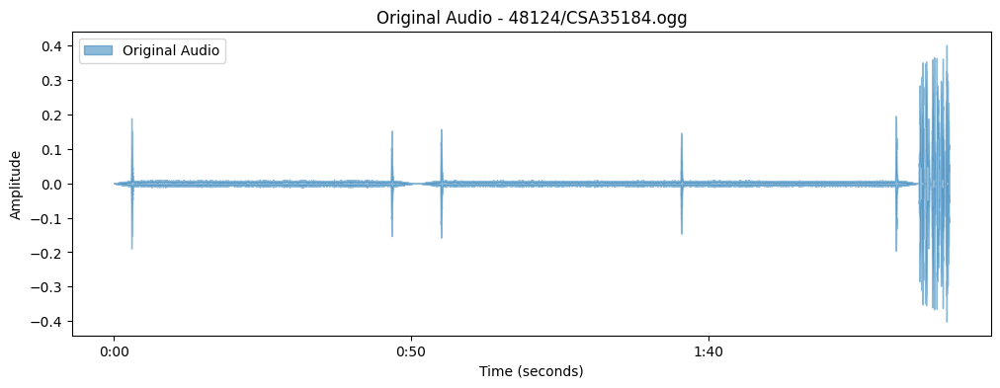

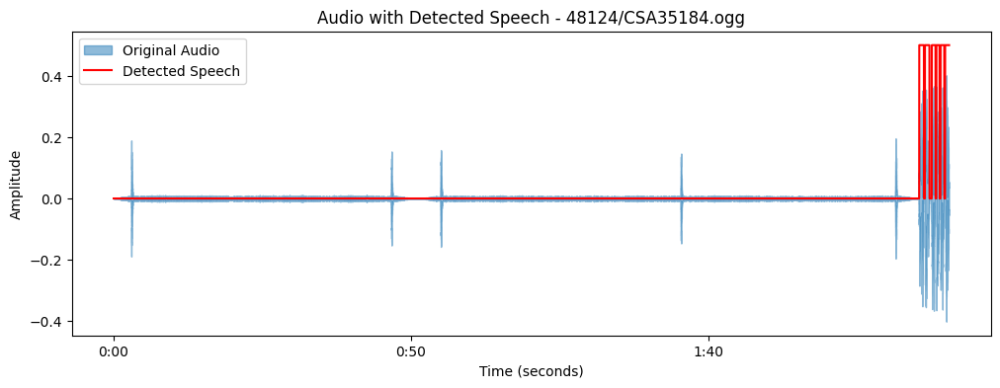





File: banana/XC331387.ogg
No speech detected in this file.




File: amakin1/XC128806.ogg
No speech detected in this file.




File: 715170/CSA35805.ogg
Original Audio:


In [ ]:
from IPython.display import Audio

df = train_df
count = 5

# Process each file
for _, row in df.iterrows():

    if count == 0:
        break
    
    print(f"\n\n\n\nFile: {row['filename']}")
    file_name = row['filename']
    file_path = os.path.join(train_audio_dir_path, row["filename"])
    
    waveform, sr = torchaudio.load(file_path)





    ############# Human Speach Ditection #############
    # Convert to mono if needed
    if waveform.shape[0] > 1:
        waveform = waveform.mean(dim=0, keepdim=True)


    # Get timestamps of human speech in audio file
    speech_timestamps = get_speech_timestamps(waveform, human_speach_ditection_model, sampling_rate=sr, threshold=0.35)

    if len(speech_timestamps) != 0:

        # Lower counter:
        count -= 1

        # Convert to numpy array for visualization
        wav_np = waveform.numpy().squeeze()

        ############# Play the original audio #############
        print("Original Audio:")
        display(Audio(wav_np, rate=sr))
    
        ############# Plot Original Audio #############
        plt.figure(figsize=(12, 4))
        librosa.display.waveshow(wav_np, sr=sr, alpha=0.5, label="Original Audio")
        plt.xlabel("Time (seconds)")
        plt.ylabel("Amplitude")
        plt.title(f"Original Audio - {file_name}")
        plt.legend()
        plt.show()
        
        
        ############# Mask/zero human speech audio segments #############
        # Mask (Zero) parts of audio with detected human voice
        mask = np.ones_like(waveform.numpy().squeeze())
        for segment in speech_timestamps:
            mask[segment['start']:segment['end']] = 0  # Mute speech
        wav_no_speech = torch.tensor(waveform.numpy() * mask, dtype=torch.float32)

        ############# Create segmentation mask for speech detection #############
        speech_signal = np.zeros_like(wav_np)
        for segment in speech_timestamps:
            speech_signal[segment['start']: segment['end']] = 0.5  # Visual cue for detected speech

        
        ############# Plot Audio waveform with human speach detection #############
        # Plot waveform and speech signal
        plt.figure(figsize=(12, 4))
        librosa.display.waveshow(wav_np, sr=sr, alpha=0.5, label="Original Audio")
        plt.plot(np.arange(len(speech_signal)) / sr, speech_signal, 'r', label="Detected Speech")
        plt.xlabel("Time (seconds)")
        plt.ylabel("Amplitude")
        plt.title(f"Audio with Detected Speech - {file_name}")
        plt.legend()
        plt.show()

        # # Convert to numpy for visualization
        # wav_no_speech_np = wav_no_speech.numpy().squeeze()
        # # Plot the audio after speech removal
        # plt.figure(figsize=(12, 4))
        # librosa.display.waveshow(wav_no_speech_np, sr=sr, alpha=0.5, label="Audio After Speech Removal")
        # plt.plot(np.arange(len(speech_signal)) / sr, speech_signal, 'r', label="Detected Speech")
        # plt.xlabel("Time (seconds)")
        # plt.ylabel("Amplitude")
        # plt.title(f"Audio After Speech Removal - {file_name}")
        # plt.legend()
        # plt.show()

        # # Play the audio after removing speech
        # print("Playing audio after speech removal...")
        # display(Audio(wav_no_speech_np, rate=sr))

    else:
        print("No speech detected in this file.")
